# IMPORTS

In [68]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objs as go
import plotly.figure_factory as ff
from plotly.offline import iplot, init_notebook_mode
init_notebook_mode()

from sklearn import model_selection
from sklearn import metrics, ensemble, linear_model
import xgboost as xgb
import catboost as cb
import lightgbm as lgb
from sklearn.experimental import enable_hist_gradient_boosting
from sklearn.ensemble import HistGradientBoostingRegressor
import warnings
warnings.filterwarnings('ignore') 

# DATA LOADING

In [69]:
train = pd.read_csv(r'C:\Users\vardh\OneDrive\Desktop\walmart_dataset\train.csv')
test = pd.read_csv(r'C:\Users\vardh\OneDrive\Desktop\walmart_dataset\test.csv')
stores = pd.read_csv(r'C:\Users\vardh\OneDrive\Desktop\walmart_dataset\stores.csv')
features = pd.read_csv(r'C:\Users\vardh\OneDrive\Desktop\walmart_dataset\features.csv')
sample_submission = pd.read_csv(r'C:\Users\vardh\OneDrive\Desktop\walmart_dataset\sampleSubmission.csv')

In [70]:
feature_store = features.merge(stores, how='inner', on = "Store")

In [71]:
train_df = train.merge(feature_store, how='inner', on = ['Store','Date','IsHoliday']).sort_values(by=['Store','Dept','Date']).reset_index(drop=True)
test_df = test.merge(feature_store, how='inner', on = ['Store','Date','IsHoliday']).sort_values(by = ['Store','Dept','Date']).reset_index(drop=True)

In [72]:
train_df.describe()

,Store,Dept,Weekly_Sales,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size
count,421570.000000,421570.000000,421570.000000,421570.000000,421570.000000,150681.000000,111248.000000,137091.000000,134967.000000,151432.000000,421570.000000,421570.000000,421570.000000
mean,22.200546,44.260317,15981.258123,60.090059,3.361027,7246.420196,3334.628621,1439.421384,3383.168256,4628.975079,171.201947,7.960289,136727.915739
std,12.785297,30.492054,22711.183519,18.447931,0.458515,8291.221345,9475.357325,9623.078290,6292.384031,5962.887455,39.159276,1.863296,60980.583328
min,1.000000,1.000000,-4988.940000,-2.060000,2.472000,0.270000,-265.760000,-29.100000,0.220000,135.160000,126.064000,3.879000,34875.000000
25%,11.000000,18.000000,2079.650000,46.680000,2.933000,2240.270000,41.600000,5.080000,504.220000,1878.440000,132.022667,6.891000,93638.000000
50%,22.000000,37.000000,7612.030000,62.090000,3.452000,5347.450000,192.000000,24.600000,1481.310000,3359.450000,182.318780,7.866000,140167.000000
75%,33.000000,74.000000,20205.852500,74.280000,3.738000,9210.900000,1926.940000,103.990000,3595.040000,5563.800000,212.416993,8.572000,202505.000000
max,45.000000,99.000000,693099.360000,100.140000,4.468000,88646.760000,104519.540000,141630.610000,67474.850000,108519.280000,227.232807,14.313000,219622.000000


In [73]:
test_df.describe()

,Store,Dept,Temperature,Fuel_Price,MarkDown1,MarkDown2,MarkDown3,MarkDown4,MarkDown5,CPI,Unemployment,Size
count,115064.000000,115064.000000,115064.000000,115064.000000,114915.000000,86437.000000,105235.000000,102176.000000,115064.000000,76902.000000,76902.000000,115064.000000
mean,22.238207,44.339524,53.941804,3.581546,7689.216439,3734.051729,2403.088666,3356.219071,3922.681189,176.961347,6.868733,136497.688921
std,12.809930,30.656410,18.724153,0.239442,10698.760716,8323.495014,13767.939313,7570.501545,19445.150745,41.239967,1.583427,61106.926438
min,1.000000,1.000000,-7.290000,2.872000,-2781.450000,-35.740000,-179.260000,0.220000,-185.170000,131.236226,3.684000,34875.000000
25%,11.000000,18.000000,39.820000,3.431000,1966.460000,180.350000,15.100000,155.460000,1309.300000,138.402033,5.771000,93638.000000
50%,22.000000,37.000000,54.470000,3.606000,4842.290000,742.590000,78.260000,840.940000,2390.430000,192.304445,6.806000,140167.000000
75%,33.000000,74.000000,67.350000,3.766000,9439.140000,2735.670000,272.580000,3096.920000,4227.270000,223.244532,8.036000,202505.000000
max,45.000000,99.000000,101.950000,4.125000,103184.980000,71074.170000,149483.310000,65344.640000,771448.100000,228.976456,10.199000,219622.000000


In [74]:
feature_store = features.merge(stores, how='inner', on = "Store")

# Converting date column to datetime 
feature_store['Date'] = pd.to_datetime(feature_store['Date'])
train['Date'] = pd.to_datetime(train['Date'])
test['Date'] = pd.to_datetime(test['Date'])

# Adding some basic datetime features
feature_store['Day'] = feature_store['Date'].dt.day
feature_store['Week'] = feature_store['Date'].dt.week
feature_store['Month'] = feature_store['Date'].dt.month
feature_store['Year'] = feature_store['Date'].dt.year

In [75]:
train_df = train.merge(feature_store, how='inner', on = ['Store','Date','IsHoliday']).sort_values(by=['Store','Dept','Date']).reset_index(drop=True)
test_df = test.merge(feature_store, how='inner', on = ['Store','Date','IsHoliday']).sort_values(by = ['Store','Dept','Date']).reset_index(drop=True)

In [76]:
df_weeks = train_df.groupby('Week').sum()

# EDA

In [77]:
palette = px.colors.qualitative.Safe

In [78]:
px.line( data_frame = df_weeks, x = df_weeks.index, y = 'Weekly_Sales', 
        labels = {'Weekly_Sales' : 'Weekly Sales', 'x' : 'Weeks' }, 
        title = 'Sales over weeks')

In [79]:
fig = go.Figure()
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown1'], name = 'MarkDown1', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown2'], name = 'MarkDown2', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown3'], name = 'MarkDown3', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown4'], name = 'MarkDown4', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['MarkDown5'], name = 'MarkDown5', mode = 'lines') )
fig.add_trace(go.Scatter( x = df_weeks.index, y = df_weeks['Weekly_Sales'], name = 'Weekly Sales', mode = 'lines') )
fig.update_layout(title = "Sales vs Markdown's", xaxis_title = 'Weeks')

In [80]:
weekly_sales = train_df.groupby(['Year','Week'], as_index = False).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2010 = train_df.loc[train_df['Year']==2010].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2011 = train_df.loc[train_df['Year']==2011].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})
weekly_sales2012 = train_df.loc[train_df['Year']==2012].groupby(['Week']).agg({'Weekly_Sales': ['mean', 'median']})

In [81]:
fig = go.Figure()
fig.add_trace(go.Scatter( x = weekly_sales2010['Weekly_Sales']['mean'].index, y = weekly_sales2010['Weekly_Sales']['mean'], name = 'Mean Sales 2010', mode = 'lines') )
fig.add_trace(go.Scatter( x = weekly_sales2011['Weekly_Sales']['mean'].index, y = weekly_sales2011['Weekly_Sales']['mean'], name = 'Mean Sales 2011', mode = 'lines') )
fig.add_trace(go.Scatter( x = weekly_sales2012['Weekly_Sales']['mean'].index, y = weekly_sales2012['Weekly_Sales']['mean'], name = 'Mean Sales 2012', mode = 'lines') )
fig.add_annotation(text="Thanksgiving", x=47, y=25000, showarrow=False)
fig.add_annotation(text="Christmas", x=51, y=29000, showarrow=False)
fig.update_layout(title = 'Sales 2010, 2011, 2012', xaxis_title = 'Weeks')

In [82]:
# Converting the temperature to celsius for a better interpretation
train_df['Temperature'] = train_df['Temperature'].apply(lambda x :  (x - 32) / 1.8)
train_df['Temperature'] = train_df['Temperature'].apply(lambda x :  (x - 32) / 1.8)

In [83]:
train_plt = train_df.sample(frac=0.20)

In [84]:
px.histogram(train_plt, x='Temperature', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title = 'Temperature and sales by holiday', color_discrete_sequence=palette)

In [85]:
px.histogram(train_plt, x='Fuel_Price', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title='Fuel price and sales by holiday',color_discrete_sequence=palette)

In [86]:
px.histogram(train_plt, x='CPI', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title='CPI and sales by holiday',color_discrete_sequence=palette)

In [87]:
px.histogram(train_plt, x='Unemployment', y ='Weekly_Sales', color='IsHoliday', marginal='box', opacity= 0.6,
             title='Unemployment rate and sales by holiday',color_discrete_sequence=palette)

In [88]:
sizes= train_plt.groupby('Size').mean()
px.line(sizes, x = sizes.index, y = sizes.Weekly_Sales, 
        title='Store size and sales')

In [89]:
store_type = pd.concat([stores['Type'], stores['Size']], axis=1)
px.box(store_type, x='Type', y='Size', color='Type', 
       title='Store size and Store type',color_discrete_sequence=palette)

In [90]:
store_sale = pd.concat([stores['Type'], train_df['Weekly_Sales']], axis=1)
px.box(store_sale.dropna(), x='Type', y='Weekly_Sales', color='Type', 
       title='Store type and sales',color_discrete_sequence=palette)

In [91]:
depts= train_plt.groupby('Dept').mean().sort_values(by='Weekly_Sales', ascending=False)
bar=px.bar(depts, x = depts.index, y =  depts.Weekly_Sales, title='Departament and sales',color=depts.Weekly_Sales)
bar.update_layout(barmode='group', xaxis={'categoryorder':'total descending'})

In [92]:
corr = train_df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
df_mask = corr.mask(mask).round(2)

fig = ff.create_annotated_heatmap(z=df_mask.to_numpy(), 
                                  x=df_mask.columns.tolist(),
                                  y=df_mask.columns.tolist(),
                                  colorscale=px.colors.diverging.RdBu,
                                  hoverinfo="none", 
                                  showscale=True, ygap=1, xgap=1
                                 )

fig.update_xaxes(side="bottom")

fig.update_layout(
    title_text='Heatmap', 
    title_x=0.5, 
    width=900, 
    height=700,
    xaxis_showgrid=False,
    yaxis_showgrid=False,
    xaxis_zeroline=False,
    yaxis_zeroline=False,
    yaxis_autorange='reversed',
    template='plotly_white'
)

for i in range(len(fig.layout.annotations)):
    if fig.layout.annotations[i].text == 'nan':
        fig.layout.annotations[i].text = ""

fig.show()

In [93]:
weekly_sales_corr = train_df.corr().iloc[2,:]
corr_df = pd.DataFrame(data = weekly_sales_corr, index = weekly_sales_corr.index ).sort_values (by = 'Weekly_Sales', ascending = False)
corr_df = corr_df.iloc[1:]
bar = px.bar(corr_df, x = corr_df.index, y = 'Weekly_Sales', color=corr_df.index, labels={'index':'Featues'},
             title='Feature correlation with sales',color_discrete_sequence=palette)
bar.update_traces(showlegend=False)

In [94]:
data_train = train_df.copy()
data_test = test_df.copy()

# FEATURE ENGINEERING

In [95]:
data_train['Days_to_Thansksgiving'] = (pd.to_datetime(train_df["Year"].astype(str)+"-11-24", format="%Y-%m-%d") - pd.to_datetime(train_df["Date"], format="%Y-%m-%d")).dt.days.astype(int)
data_train['Days_to_Christmas'] = (pd.to_datetime(train_df["Year"].astype(str)+"-12-24", format="%Y-%m-%d") - pd.to_datetime(train_df["Date"], format="%Y-%m-%d")).dt.days.astype(int)

In [96]:
data_test['Days_to_Thansksgiving'] = (pd.to_datetime(test_df["Year"].astype(str)+"-11-24", format="%Y-%m-%d") - pd.to_datetime(test_df["Date"], format="%Y-%m-%d")).dt.days.astype(int)
data_test['Days_to_Christmas'] = (pd.to_datetime(test_df["Year"].astype(str)+"-12-24", format="%Y-%m-%d") - pd.to_datetime(test_df["Date"], format="%Y-%m-%d")).dt.days.astype(int)

In [97]:
data_train['SuperBowlWeek'] = train_df['Week'].apply(lambda x: 1 if x == 6 else 0)
data_train['LaborDay'] = train_df['Week'].apply(lambda x: 1 if x == 36 else 0)
data_train['Thanksgiving'] = train_df['Week'].apply(lambda x: 1 if x == 47 else 0)
data_train['Christmas'] = train_df['Week'].apply(lambda x: 1 if x == 52 else 0)

In [98]:
data_test['SuperBowlWeek'] = test_df['Week'].apply(lambda x: 1 if x == 6 else 0)
data_test['LaborDay'] = test_df['Week'].apply(lambda x: 1 if x == 36 else 0)
data_test['Thanksgiving'] = test_df['Week'].apply(lambda x: 1 if x == 47 else 0)
data_test['Christmas'] = test_df['Week'].apply(lambda x: 1 if x == 52 else 0)

In [99]:
data_train['MarkdownsSum'] = train_df['MarkDown1'] + train_df['MarkDown2'] + train_df['MarkDown3'] + train_df['MarkDown4'] + train_df['MarkDown5'] 

In [100]:
data_test['MarkdownsSum'] = test_df['MarkDown1'] + test_df['MarkDown2'] + test_df['MarkDown3'] + test_df['MarkDown4'] + test_df['MarkDown5']

In [101]:
data_train.isna().sum()[data_train.isna().sum() > 0].sort_values(ascending=False)

MarkdownsSum    324514
MarkDown2       310322
MarkDown4       286603
MarkDown3       284479
MarkDown1       270889
MarkDown5       270138
dtype: int64

In [102]:
data_test.isna().sum()[data_test.isna().sum() > 0].sort_values(ascending=False)

CPI             38162
Unemployment    38162
MarkdownsSum    37457
MarkDown2       28627
MarkDown4       12888
MarkDown3        9829
MarkDown1         149
dtype: int64

In [103]:
data_train.fillna(0, inplace = True)

In [104]:
data_test['CPI'].fillna(data_test['CPI'].mean(), inplace = True)
data_test['Unemployment'].fillna(data_test['Unemployment'].mean(), inplace = True)

In [105]:
data_test.fillna(0, inplace = True)

In [106]:
data_train['IsHoliday'] = data_train['IsHoliday'].apply(lambda x: 1 if x == True else 0)
data_test['IsHoliday'] = data_test['IsHoliday'].apply(lambda x: 1 if x == True else 0)

In [107]:
data_train['Type'] = data_train['Type'].apply(lambda x: 1 if x == 'A' else (2 if x == 'B' else 3))
data_test['Type'] = data_test['Type'].apply(lambda x: 1 if x == 'A' else (2 if x == 'B' else 3))

# FEATURE SELECTION

In [108]:
features = [feature for feature in data_train.columns if feature not in ('Date','Weekly_Sales')]

In [109]:
X = data_train[features].copy()
y = data_train.Weekly_Sales.copy()

In [110]:
data_sample = data_train.copy().sample(frac=.25)
X_sample = data_sample[features].copy()
y_sample = data_sample.Weekly_Sales.copy()

In [111]:
X_train, X_valid, y_train, y_valid = model_selection.train_test_split(X_sample, y_sample, random_state=0, test_size=0.15)

In [112]:
feat_model = xgb.XGBRegressor(random_state=0).fit(X_train, y_train)

In [113]:
import eli5
from eli5.sklearn import PermutationImportance

perm = PermutationImportance(feat_model, random_state=1).fit(X_valid, y_valid)
features = eli5.show_weights(perm, top=len(X_train.columns), feature_names = X_valid.columns.tolist())

In [114]:
features_weights = eli5.show_weights(perm, top=len(X_train.columns), feature_names = X_valid.columns.tolist())
features_weights

Weight,Feature
1.6713 ± 0.0429,Dept
0.4259 ± 0.0116,Size
0.1279 ± 0.0047,Store
0.0438 ± 0.0028,CPI
0.0382 ± 0.0030,Week
0.0160 ± 0.0005,Type
0.0158 ± 0.0030,Thanksgiving
0.0114 ± 0.0016,Days_to_Thansksgiving
0.0103 ± 0.0022,Day
0.0069 ± 0.0011,Unemployment


In [115]:
weights = eli5.show_weights(perm, top=len(X_train.columns), feature_names=X_valid.columns.tolist())
result = pd.read_html(weights.data)[0]
result

,Weight,Feature
0,1.6713 ± 0.0429,Dept
1,0.4259 ± 0.0116,Size
2,0.1279 ± 0.0047,Store
3,0.0438 ± 0.0028,CPI
4,0.0382 ± 0.0030,Week
5,0.0160 ± 0.0005,Type
6,0.0158 ± 0.0030,Thanksgiving
7,0.0114 ± 0.0016,Days_to_Thansksgiving
8,0.0103 ± 0.0022,Day
9,0.0069 ± 0.0011,Unemployment


# EVALUATION METRIC

In [116]:
# Eval metric for the competition
def WMAE(dataset, real, predicted):
    weights = dataset.IsHoliday.apply(lambda x: 5 if x else 1)
    return np.round(np.sum(weights*abs(real-predicted))/(np.sum(weights)), 2)

In [117]:
X_baseline = X[['Store','Dept','IsHoliday','Size','Week','Type','Year','Day']].copy()

# DATA SPLITTING

In [118]:
X_train, X_valid, y_train, y_valid = model_selection.train_test_split(X_baseline, y, random_state=0, test_size=0.1)

In [119]:
train_inputs = X_train
train_targets = y_train
val_inputs = X_valid
val_targets = y_valid

# MODELLING

In [120]:
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from xgboost import XGBRegressor

In [121]:
model_list = ['Linear Regression', 'Ridge Regression', 'Decision Tree', 'Random Forest', 'Xgboost', 'Extra Trees']
training_wmae_list = []
testing_wmae_list = []

### LINEAR REGRESSION

In [122]:
#build the model
model1 = LinearRegression().fit(train_inputs, train_targets)
#training error
linear_train_wmae = WMAE(train_inputs, model1.predict(train_inputs), train_targets)
#validation error
y_pred = model1.predict(val_inputs)
linear_val_wmae = WMAE(val_inputs, y_pred, val_targets)
#results
print('Training dataset WMAE is', linear_train_wmae)
print('Validation dataset WMAE is', linear_val_wmae)

Training dataset WMAE is 14808.15
Validation dataset WMAE is 14834.85


### RIDGE REGRESSION

In [123]:
model2 = Ridge().fit(train_inputs, train_targets)
#train error
ridge_train_wmae = WMAE(train_inputs, model2.predict(train_inputs), train_targets)

#validation error
y_pred = model2.predict(val_inputs)
ridge_val_wmae = WMAE(val_inputs, y_pred, val_targets)

#results:
print('Training dataset WMAE is', ridge_train_wmae)
print('Validation dataset WMAE is', ridge_val_wmae)

Training dataset WMAE is 14808.15
Validation dataset WMAE is 14834.85


### DECISION TREE

In [124]:
model3 = DecisionTreeRegressor(random_state=0).fit(train_inputs, train_targets)
#train error
tree_train_wmae = WMAE(train_inputs, model2.predict(train_inputs), train_targets)

#validation error
y_pred = model3.predict(val_inputs)
tree_val_wmae = WMAE(val_inputs, y_pred, val_targets)

#results:
print('Training dataset WMAE is', tree_train_wmae)
print('Validation dataset WMAE is', tree_val_wmae)

Training dataset WMAE is 14808.15
Validation dataset WMAE is 1709.88


In [128]:
def test_params(**params):  
    model = RandomForestRegressor(random_state=0, n_jobs=-1, **params).fit(X_train, y_train)
    train_wmae = WMAE(X_train, y_train, model.predict(X_train))
    val_wmae = WMAE(X_valid, y_valid, model.predict(X_valid))
    return train_wmae, val_wmae

In [129]:
def test_param_and_plot(param_name, param_values):
    train_errors, val_errors = [], [] 
    for value in param_values:
        params = {param_name: value}
        train_wmae, val_wmae = test_params(**params)
        train_errors.append(train_wmae)
        val_errors.append(val_wmae)
    plt.figure(figsize=(16,8))
    plt.title('Overfitting curve: ' + param_name)
    plt.plot(param_values, train_errors, 'b-o')
    plt.plot(param_values, val_errors, 'r-o')
    plt.xlabel(param_name)
    plt.ylabel('WMAE')
    plt.legend(['Training', 'Validation'])

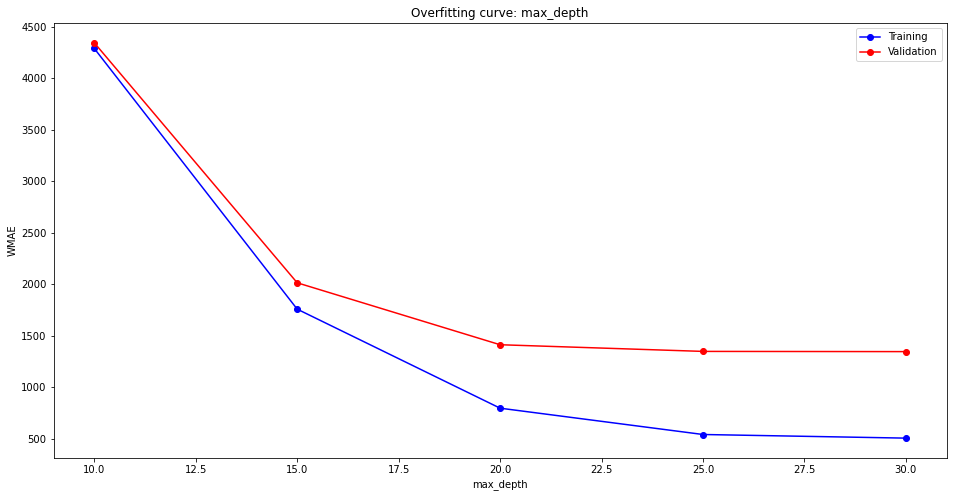

In [130]:
test_param_and_plot('max_depth', [10, 15, 20, 25, 30])

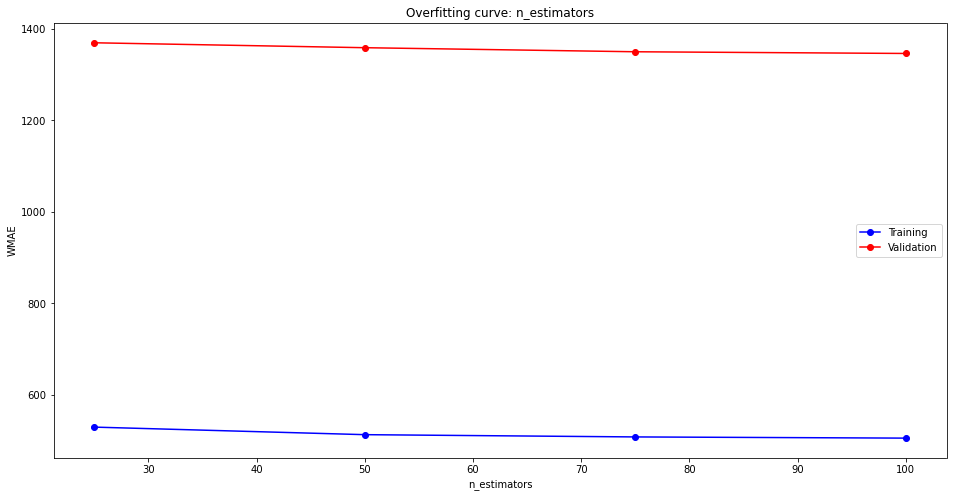

In [131]:
test_param_and_plot('n_estimators', [25, 50, 75, 100])

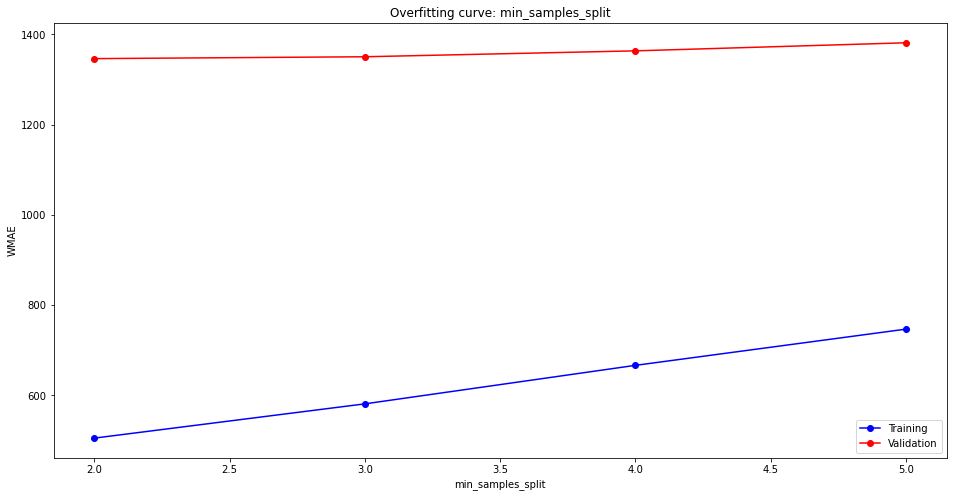

In [132]:
test_param_and_plot('min_samples_split', [2, 3, 4, 5])

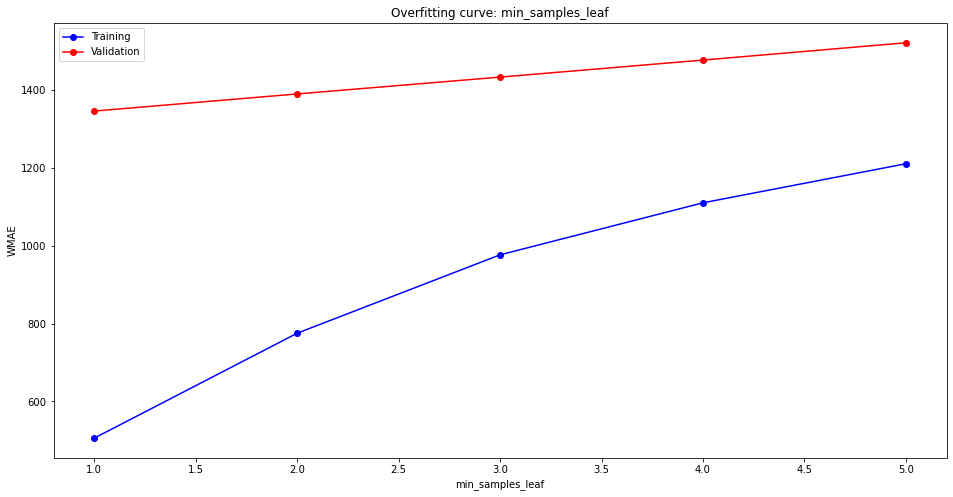

In [133]:
test_param_and_plot('min_samples_leaf', [1, 2, 3, 4, 5])

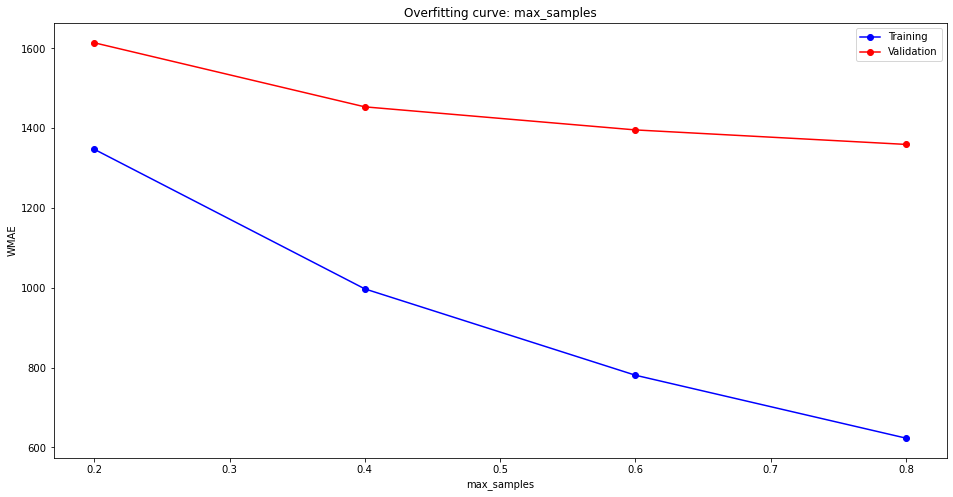

In [134]:
test_param_and_plot('max_samples', [0.2, 0.4, 0.6, 0.8])

In [135]:
#test_param_and_plot('max_features', [2, 4, 6])

KeyboardInterrupt: 

### RANDOM FOREST

In [ ]:
#Create the model
rf1 = RandomForestRegressor(random_state=0, n_estimators=100, max_depth=25, min_samples_split=2, min_samples_leaf=1)

# Fit the model
rf1.fit(train_inputs, train_targets)
rf1_train_pred = rf1.predict(train_inputs)

# Compute WMAE on traing data
rf1_train_wmae = WMAE(train_inputs, train_targets, rf1_train_pred)
#print('The WMAE loss for the training set is  {}.'.format(rf1_train_wmae))

rf1_val_preds = rf1.predict(val_inputs)

# Compute WMAE on validation data
rf1_val_wmae = WMAE(val_inputs, val_targets, rf1_val_preds)
#print('The WMAE loss for the validation set is  {}.'.format(rf1_val_wmae))

#results:
print('Training dataset WMAE is', rf1_train_wmae)
print('Validation dataset WMAE is', rf1_val_wmae)

### XGBOOST

In [60]:
# Create the model
'''xgb1 = XGBRegressor(random_state=0, n_estimators=1000, learning_rate = 0.6, max_depth=15)

# Fit the model
xgb1.fit(X_train, y_train)



# Compute WMAE on traing data
xgb1_train_preds = xgb1.predict(X_train)
xgb1_train_wmae = WMAE(X_train, y_train, xgb1_train_preds)
#print('The WMAE loss for the training set is  {}.'.format(xgb1_train_wmae))


# Compute WMAE on validation data
xgb1_val_preds = xgb1.predict(X_valid)
xgb1_val_wmae = WMAE(X_valid, y_valid, xgb1_val_preds)
#print('The WMAE loss for the validation set is  {}.'.format(xgb1_val_wmae))

#results:
print('Training dataset WMAE is', xgb1_train_wmae)
print('Validation dataset WMAE is', xgb1_val_wmae)'''

Training dataset WMAE is 0.0
Validation dataset WMAE is 1361.48


### EXTRA TREES

In [61]:
# Create the model
ETR = ensemble.ExtraTreesRegressor(n_estimators=50, bootstrap = True, random_state = 0)

# Fit the model
ETR.fit(X_train, y_train)

# Compute WMAE on traing data
ETR_train_preds = ETR.predict(X_train)
ETR_train_wmae = WMAE(X_train, y_train, ETR_train_preds)
#print('The WMAE loss for the training set is  {}.'.format(xgb1_train_wmae))


# Compute WMAE on validation data
ETR_val_preds = ETR.predict(X_valid)
ETR_val_wmae = WMAE(X_valid, y_valid, ETR_val_preds)
#print('The WMAE loss for the validation set is  {}.'.format(xgb1_val_wmae))

#results:
print('Training dataset WMAE is', ETR_train_wmae)
print('Validation dataset WMAE is', ETR_val_wmae)

Training dataset WMAE is 609.17
Validation dataset WMAE is 1562.77


In [62]:
training_wmae_list.append(linear_train_wmae)
training_wmae_list.append(ridge_train_wmae)
training_wmae_list.append(tree_train_wmae)
training_wmae_list.append(rf1_train_wmae)
#training_wmae_list.append(xgb1_train_wmae)
training_wmae_list.append(ETR_train_wmae)

testing_wmae_list.append(linear_val_wmae)
testing_wmae_list.append(ridge_val_wmae)
testing_wmae_list.append(tree_val_wmae)
testing_wmae_list.append(rf1_val_wmae)
#testing_wmae_list.append(xgb1_val_wmae)
testing_wmae_list.append(ETR_val_wmae)

In [67]:
for i in range(5):
    print("For " + model_list[i] + " : Training WMAE is " + str(training_wmae_list[i]) + " & Testing WMAE is " + str(testing_wmae_list[i]))

For Linear Regression : Training WMAE is 14808.15 & Testing WMAE is 14834.85
For Ridge Regression : Training WMAE is 14808.15 & Testing WMAE is 14834.85
For Decision Tree : Training WMAE is 14808.15 & Testing WMAE is 1709.88
For Random Forest : Training WMAE is 614.65 & Testing WMAE is 1364.07
For Xgboost : Training WMAE is 0.0 & Testing WMAE is 1361.48
For Extra Trees : Training WMAE is 609.17 & Testing WMAE is 1562.77


In [87]:
test = data_test[['Store','Dept','IsHoliday','Size','Week','Type','Year','Day']].copy()
predict_rf = rf1.predict(test)
predict_etr = ETR.predict(test)

In [88]:
avg_preds = (predict_rf + predict_etr) / 2

In [90]:
sample_submission['Weekly_Sales'] = avg_preds
sample_submission.to_csv('submission_rf_etr.csv',index=False)